# HW4: Neural Networks for Dynamical Systems
---
Neural networks are used to model a series of dynamical systems. It's found that this approach is compute intensive, and that parameter-tuning is difficult. The theoretical underpinnings are beautiful, but it seems a GPU, IPU, or TPU might be beneficial in this quest.

## Ugly initialisations and library stuff


In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import scipy.io
from scipy import integrate
import keras
import imageio
import glob
from IPython import display
from mpl_toolkits.mplot3d import Axes3D

Using TensorFlow backend.


In [2]:
# My Colour scheme
#  every self-respecting/loathing millenial has their own, right?
orange = '#FFA500'
millenialPink = '#FFAADD'
mediumAquamarine = '#66CDAA'

# Custom cmap
from matplotlib.colors import LinearSegmentedColormap

colours = [orange,millenialPink]
cm = LinearSegmentedColormap.from_list('customCmap', colours, N=1024)

## Question1: Train a NN that can advance the solution from t to t + ∆t for the KS equation

In [3]:
# Load the data
#  Stored in a .mat atm, yuk!
filePath = './kuramoto_sivishinky.mat'

In [4]:
ksData = scipy.io.loadmat(filePath)

In [5]:
print(ksData.keys())

dict_keys(['__header__', '__version__', '__globals__', 'tt', 'uu', 'x'])


In [6]:
tt = ksData['tt']
uu = ksData['uu']
x = ksData['x']
print([x.shape,tt.shape,uu.shape])
# tt and x just define the region of uu
# uu progresses in time along second axis, 251 timestamps

[(1024, 1), (1, 251), (1024, 251)]


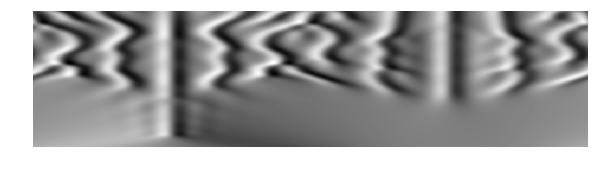

In [7]:
# Plot original - to check we've opened the data correctly
plt.figure(figsize=(10,2.5))
plt.imshow(uu.T,origin='lower',cmap='gray')
plt.axis('off')
plt.show()

In [8]:
# Create training data.
xTrain = uu.T[:-1]
yTrain = uu.T[1:]
N = xTrain.shape[1]

In [9]:
print([xTrain.shape,yTrain.shape])

[(250, 1024), (250, 1024)]


In [10]:
# Create a neural network - pretty basic and uninteresting
model = keras.Sequential()
model.add(keras.layers.Dense(N))
model.add(keras.layers.Dense(2*N,activation='linear'))
model.add(keras.layers.Dense(2*N,activation='sigmoid'))
model.add(keras.layers.Dense(2*N,activation='tanh'))
model.add(keras.layers.Dense(N))

In [11]:
o = keras.optimizers.SGD()

In [12]:
# Train
model.compile(optimizer=o,loss='mean_squared_error')
mF = model.fit(xTrain,yTrain,epochs=32,validation_split=0.2,verbose=1,workers=4)

Train on 200 samples, validate on 50 samples
Epoch 1/32
200/200 [==============================] - 2s 11ms/step - loss: 1.1745 - val_loss: 1.8177
Epoch 2/32
200/200 [==============================] - 2s 8ms/step - loss: 1.0430 - val_loss: 1.7443
Epoch 3/32
200/200 [==============================] - 2s 9ms/step - loss: 0.9450 - val_loss: 1.6948
Epoch 4/32
200/200 [==============================] - 2s 8ms/step - loss: 0.8692 - val_loss: 1.6566
Epoch 5/32
200/200 [==============================] - 2s 8ms/step - loss: 0.8096 - val_loss: 1.6257
Epoch 6/32
200/200 [==============================] - 2s 9ms/step - loss: 0.7617 - val_loss: 1.5984
Epoch 7/32
200/200 [==============================] - 2s 8ms/step - loss: 0.7231 - val_loss: 1.5813
Epoch 8/32
200/200 [==============================] - 2s 8ms/step - loss: 0.6916 - val_loss: 1.5650
Epoch 9/32
200/200 [==============================] - 2s 9ms/step - loss: 0.6652 - val_loss: 1.5520
Epoch 10/32
200/200 [==============================] -

In [13]:
# Make some predictions
p = np.zeros(uu.T.shape)
p[0] = uu.T[0] # Initial prediction conditions as x_0
for i in range(p.shape[0]-1):
    p[i+1] = model.predict(np.array([p[i]]))

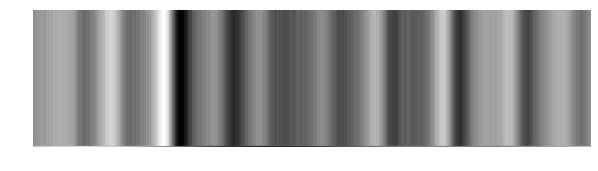

In [14]:
# Plot predictions
plt.figure(figsize=(10,7.5))
plt.imshow(p,origin='lower',cmap='gray')
plt.axis('off')
plt.savefig('./Images/q1pred')
plt.show()

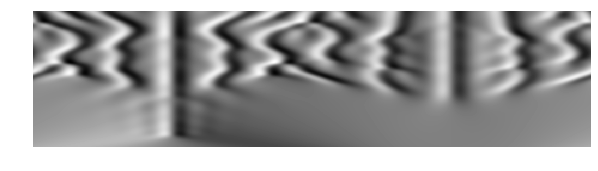

In [15]:
# Compare with real
plt.figure(figsize=(10,7.5))
plt.imshow(xTrain,origin='lower',cmap='gray')
plt.axis('off')
plt.savefig('./Images/q1true')
plt.show()

In [16]:
# Trying different initial conditions
filePath = './kuramoto_sivishinky_2.mat'
ksData = scipy.io.loadmat(filePath)
tt = ksData['tt']
uu = ksData['uu']
x = ksData['x']
print([x.shape,tt.shape,uu.shape])
# tt and x just define the region of uu
# uu progresses in time along second axis, 251 timestamps

[(1024, 1), (1, 251), (1024, 251)]


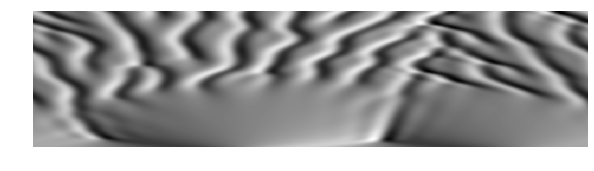

In [17]:
# plot true
plt.figure(figsize=(10,2.5))
plt.imshow(uu.T,origin='lower',cmap='gray')
plt.axis('off')
plt.savefig('./Images/q1_2true.png')
plt.show()

In [18]:
# More predictions
p = np.zeros(uu.T.shape)
p[0] = uu.T[0]
for i in range(p.shape[0]-1):
    p[i+1] = model.predict(np.array([p[i]]))

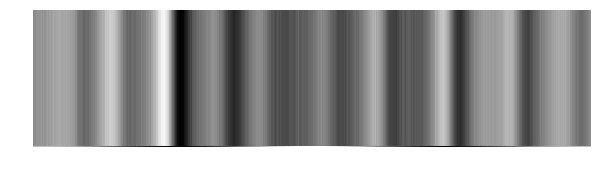

In [19]:
# And plot
plt.figure(figsize=(10,7.5))
plt.imshow(p,origin='lower',cmap='gray')
plt.axis('off')
plt.savefig('./Images/q1_2pred2')
plt.show()

## Question 2: Reaction Diffusion

In [20]:
# Load the data
#  Stored in a .mat atm, yuk!
filePath = './reaction_diffusion_big.mat'

In [21]:
rdData = scipy.io.loadmat(filePath)

In [22]:
print(rdData.keys())

dict_keys(['__header__', '__version__', '__globals__', 't', 'u', 'v', 'x', 'y'])


In [23]:
t = rdData['t']
u = rdData['u']
v = rdData['v']
x = rdData['x']
y = rdData['y']
print([t.shape,u.shape,v.shape,x.shape,y.shape])

[(201, 1), (512, 512, 201), (512, 512, 201), (1, 512), (1, 512)]


In [24]:
# Stolen from a previous project 
#  CSE573 AI final proj, investigating 'stability' of autoencoders interpreted ass a dynamical system
#  https://colab.research.google.com/drive/1XCOS9NaT9olQRbiZG2lg8MTJKvEpr6Fd
def CreateGIF(anim_file,searchTerm):
    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob(searchTerm+'_[0-9]*.png')
        filenames = sorted(filenames)
        last = -1
        for i,filename in enumerate(filenames):
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

In [25]:
def SaveImages(Im,folderPath,fileName,number=True):
    for i in range(Im.shape[0]):
        #print('Saving image '+str(i+1)+' of '+str(Im.shape[0]))
        fN = folderPath+'/'+fileName
        if number == True: fN+='_{:05d}'.format(i)
        plt.imshow(Im[i],cmap='gray',aspect='auto')
        plt.axis('off')
        plt.gca().set_axis_off()
        plt.subplots_adjust(top = 1, bottom = 0, right = 1, left = 0,hspace = 0, wspace = 0)
        plt.margins(0,0)
        plt.gca().xaxis.set_major_locator(plt.NullLocator())
        plt.gca().yaxis.set_major_locator(plt.NullLocator())
        plt.savefig(fN+'.png')
        plt.close()

In [26]:
SaveImages(np.array(u.T),'./DATA/Images','u')

In [4]:
#CreateGIF('u.gif','./DATA/Images/u')
#display.Image('u.gif')

In [28]:
SaveImages(np.array(v.T),'./DATA/Images','v')

In [5]:
#CreateGIF('v.gif','./DATA/Images/v')
#display.Image('v.gif')

In [30]:
# Set rows and cols
rows = 512
cols = 512

In [31]:
# Vectorise images
u = np.reshape(u.T,(u.T.shape[0],rows*cols))
print(u.shape)

(201, 262144)


In [32]:
# SVD
U_u,S_u,Vh_u = np.linalg.svd(u.T,full_matrices=0)
print([U_u.shape,S_u.shape,Vh_u.shape])

[(262144, 201), (201,), (201, 201)]


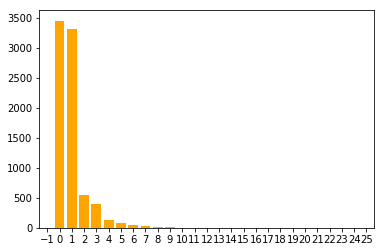

In [33]:
# Plot SVD eigenvalues
[start,end] = [0,25]
plt.bar(range(len(S_u[start:end])),S_u[start:end],color=orange)
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))
plt.savefig('./Images/modesBar.png')

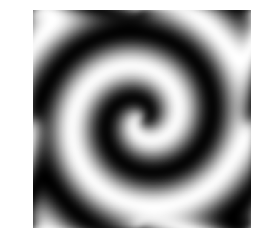

In [34]:
plt.imshow(np.reshape(U_u[:,0],(rows,cols)),cmap='gray')
plt.axis('off')
plt.show()

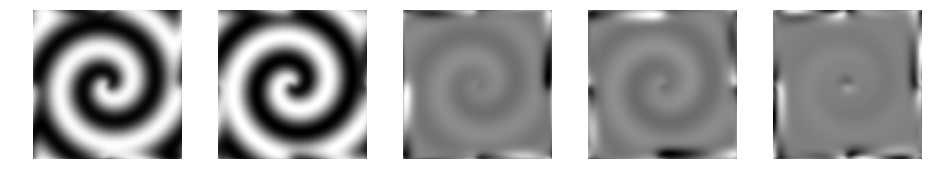

In [35]:
# Plot a few.
n = 5
f, axs = plt.subplots(1,n,figsize=(13,4))
for i in range(n):
    axs[i].imshow(np.reshape(U_u[:,i],(rows,cols)),cmap='gray')
    axs[i].axis('off')
f.tight_layout()
f.savefig('./images/modes.png')

In [36]:
# ... and therefore choose 10 modes
r_u = 20
Ut_u = U_u[:,:r_u]
print(Ut_u.shape)

(262144, 20)


In [37]:
ur = Ut_u.T @ u.T
print(ur.shape)

(20, 201)


In [38]:
# Same as above palava but for v.
v = np.reshape(v.T,(v.T.shape[0],rows*cols))
print(v.shape)

(201, 262144)


In [39]:
U_v,S_v,Vh_v = np.linalg.svd(v.T,full_matrices=0)
print([U_v.shape,S_v.shape,Vh_v.shape])

[(262144, 201), (201,), (201, 201)]


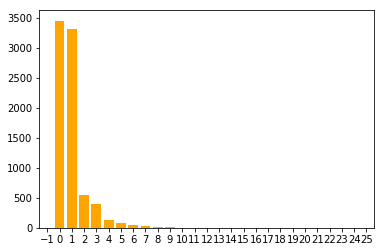

In [40]:
[start,end] = [0,25]
plt.bar(range(len(S_v[start:end])),S_v[start:end],color=orange)
plt.gca().xaxis.set_major_locator(mticker.MultipleLocator(1))

In [41]:
# ... and therefore choose 10 modes
r_v = 20
Ut_v = U_v[:,:r_v]
print(Ut_v.shape)

(262144, 20)


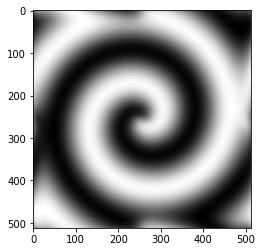

In [42]:
plt.imshow(np.reshape(U_v[:,0],(rows,cols)),cmap='gray')

In [43]:
vr = Ut_v.T @ v.T
print(vr.shape)

(20, 201)


In [44]:
# Create training set using.. - ok looking back at this after submitting this feels totally wrong
X = np.append(ur,vr,axis=0)
print(X.shape)

(40, 201)


In [45]:
X = X.T
Y = X[1:]
X = X[:-1]
print([X.shape,Y.shape])
N = X.shape[1]

[(200, 40), (200, 40)]


In [46]:
# Create a neural network
model = keras.Sequential()
model.add(keras.layers.Dense(N))
model.add(keras.layers.Dense(2*N,activation='linear'))
model.add(keras.layers.Dense(2*N,activation='sigmoid'))
model.add(keras.layers.Dense(2*N,activation='tanh'))
model.add(keras.layers.Dense(N))

In [47]:
o = keras.optimizers.SGD()

In [48]:
model.compile(optimizer=o,loss='mean_squared_error')
mF = model.fit(X,Y,epochs=256,validation_split=0.1,verbose=1,workers=4)

Train on 180 samples, validate on 20 samples
Epoch 1/256
180/180 [==============================] - 0s 2ms/step - loss: 5643.8170 - val_loss: 5489.7002
Epoch 2/256
180/180 [==============================] - 0s 159us/step - loss: 5008.3566 - val_loss: 4724.1055
Epoch 3/256
180/180 [==============================] - 0s 201us/step - loss: 4508.1072 - val_loss: 4963.2930
Epoch 4/256
180/180 [==============================] - 0s 291us/step - loss: 4426.9783 - val_loss: 4677.6860
Epoch 5/256
180/180 [==============================] - 0s 256us/step - loss: 3804.6797 - val_loss: 4606.7046
Epoch 6/256
180/180 [==============================] - 0s 272us/step - loss: 3539.3651 - val_loss: 4646.3291
Epoch 7/256
180/180 [==============================] - 0s 265us/step - loss: 4038.5801 - val_loss: 4036.4343
Epoch 8/256
180/180 [==============================] - 0s 197us/step - loss: 3352.0777 - val_loss: 4799.2451
Epoch 9/256
180/180 [==============================] - 0s 198us/step - loss: 2982.340

180/180 [==============================] - 0s 170us/step - loss: 103.5322 - val_loss: 222.7826
Epoch 152/256
180/180 [==============================] - 0s 247us/step - loss: 103.7651 - val_loss: 226.7958
Epoch 153/256
180/180 [==============================] - ETA: 0s - loss: 122.768 - 0s 267us/step - loss: 103.5467 - val_loss: 233.5563
Epoch 154/256
180/180 [==============================] - 0s 311us/step - loss: 103.3698 - val_loss: 226.1092
Epoch 155/256
180/180 [==============================] - 0s 183us/step - loss: 104.1132 - val_loss: 225.3264
Epoch 156/256
180/180 [==============================] - 0s 239us/step - loss: 103.5404 - val_loss: 227.3166
Epoch 157/256
180/180 [==============================] - 0s 221us/step - loss: 102.7439 - val_loss: 233.5405
Epoch 158/256
180/180 [==============================] - 0s 194us/step - loss: 103.0395 - val_loss: 241.2855
Epoch 159/256
180/180 [==============================] - 0s 177us/step - loss: 102.8785 - val_loss: 228.0072
Epoch 1

Epoch 226/256
180/180 [==============================] - 0s 441us/step - loss: 96.9589 - val_loss: 280.5876
Epoch 227/256
180/180 [==============================] - 0s 188us/step - loss: 96.5254 - val_loss: 275.5326
Epoch 228/256
180/180 [==============================] - 0s 262us/step - loss: 97.3525 - val_loss: 280.4438
Epoch 229/256
180/180 [==============================] - 0s 193us/step - loss: 96.8217 - val_loss: 281.8221
Epoch 230/256
180/180 [==============================] - 0s 171us/step - loss: 96.1832 - val_loss: 278.4859
Epoch 231/256
180/180 [==============================] - 0s 261us/step - loss: 96.3026 - val_loss: 289.8975
Epoch 232/256
180/180 [==============================] - 0s 268us/step - loss: 96.5098 - val_loss: 287.0356
Epoch 233/256
180/180 [==============================] - 0s 190us/step - loss: 96.4803 - val_loss: 285.9469
Epoch 234/256
180/180 [==============================] - 0s 251us/step - loss: 96.1962 - val_loss: 285.0455
Epoch 235/256
180/180 [=====

In [49]:
x = np.array([X[-1]])
print(x)
print(x.shape) 
x = model.predict(x)
print(x)

[[-1.10824037e+02  3.20703303e+02  9.86692774e+00  4.76601408e+01
   9.20487403e+00 -5.11347837e+00  5.38980159e+00  3.68349153e+00
  -2.26450855e+00 -1.16148975e+00 -5.75137208e-01  2.82488510e-01
   1.34820631e-01 -6.58575836e-02 -3.18902328e-02 -1.52538398e-02
  -7.15101562e-03 -3.23125600e-03 -1.41729244e-03 -6.24216758e-04
  -1.10806363e+02 -3.20708335e+02 -9.87776489e+00  4.76579049e+01
   9.20724314e+00  5.11307143e+00  5.39041957e+00  3.68301805e+00
  -2.26454501e+00  1.16155413e+00  5.75109876e-01 -2.82465895e-01
   1.34828884e-01  6.58614565e-02  3.18884013e-02  1.52538297e-02
   7.15174275e-03  3.23125180e-03  1.41725009e-03 -6.24266143e-04]]
(1, 40)
[[-1.0061266e+02  3.1899384e+02  1.4808508e+01 -2.4360018e+01
  -8.6387215e+00  1.0156347e+00 -7.6031256e-01  6.1173332e-01
  -7.3367709e-01  3.8910788e-01  3.7902299e-01  1.6300516e-01
  -6.0071921e-01  5.3531194e-01 -3.6825210e-02  1.7150120e-01
  -5.2389860e-01 -2.2786230e-01 -1.5524437e-01 -1.6891553e-01
  -1.0081664e+02 -3.

In [50]:
p = np.zeros(X.shape)
p[0] = X[0]
for i in range(p.shape[0]-1):
    p[i+1] = model.predict(np.array([p[i]]))

In [51]:
p = np.array(p)
print(p.shape)

(200, 40)


In [52]:
uXr = p[:,:r_u]
print(uXr.shape)

(200, 20)


In [53]:
uX = (Ut_u @ uXr.T).T
uX = np.reshape(uX,(uX.shape[0],rows,cols))
print(uX.shape)

(200, 512, 512)


In [54]:
SaveImages(uX,'./DATA/Images','urX')

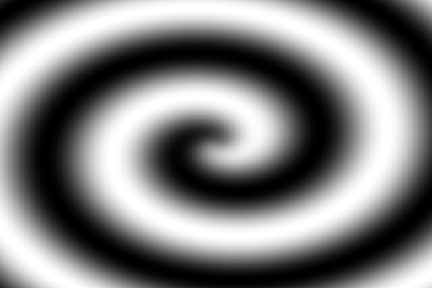

In [55]:
CreateGIF('urX.gif','./DATA/Images/urX')
display.Image('urX.gif')

## Question 3: Lorenz

In [56]:
# Variables - assumed and dictated else
beta = 8/3
sigma = 10

In [57]:
# Stolen from class resources - as is most of the following
def lorenz_deriv(x_y_z, t0, rho, sigma=sigma, beta=beta):
    x, y, z = x_y_z
    return [sigma * (y - x), x * (rho - z) - y, x * y - beta * z]

In [58]:
# Timeframe
dt = 0.01
T = 8
t = np.arange(0,T+dt,dt)

In [59]:
# Random initial conditions
n = 15
np.random.seed(123)
x0 = -15 + 30 * np.random.random((n, 3))

In [60]:
rhos = [10,28,40]
rho = 28

In [61]:
x_t = np.asarray([integrate.odeint(lorenz_deriv, x0_j, t, args=(rho,))
                  for x0_j in x0])

In [62]:
print(x_t.shape)

(15, 801, 3)


In [63]:
# Create Lorenz Dataset

# Timeframe
dt = 0.01
T = 8
t = np.arange(0,T+dt,dt)

# Random initial conditions
n = 128
np.random.seed(123)
x0 = -15 + 30 * np.random.random((n, 3))

# Rho
rhos = [10,28,40]

In [64]:
l = len(t) # length (for each integations)
w = 4 # 3vars + 1 label
# n = number of initial conditions
m = len(rhos) # #rhos

X = np.ones((w,l,n*m))

i = 0

for rho in rhos:
    for x0_j in x0:
        X[1:,:,i] = integrate.odeint(lorenz_deriv, x0_j, t, args=(rho,)).T
        X[0,:,i] *= rho
        i += 1

print(X.shape)
print(X.T[-1])

(4, 801, 384)
[[40.         13.61091358  4.73445219  8.18633492]
 [40.         12.96756836  8.84248963  8.8610374 ]
 [40.         12.76175798 12.66254264  9.99228283]
 ...
 [40.         13.93424022 16.86072694 41.60995419]
 [40.         14.19091317 16.38151966 42.82432653]
 [40.         14.36937251 15.73465878 43.96301236]]


In [65]:
Xtrain = X[:,:-1,:].T
print(Xtrain.shape)
Xtrain = np.reshape(Xtrain,(-1,4))
print(Xtrain.shape)

(384, 800, 4)
(307200, 4)


In [66]:
Y = X[:,1:,:].T
print(Y.shape)
Y = np.reshape(Y,(-1,4))
print(Y.shape)

(384, 800, 4)
(307200, 4)


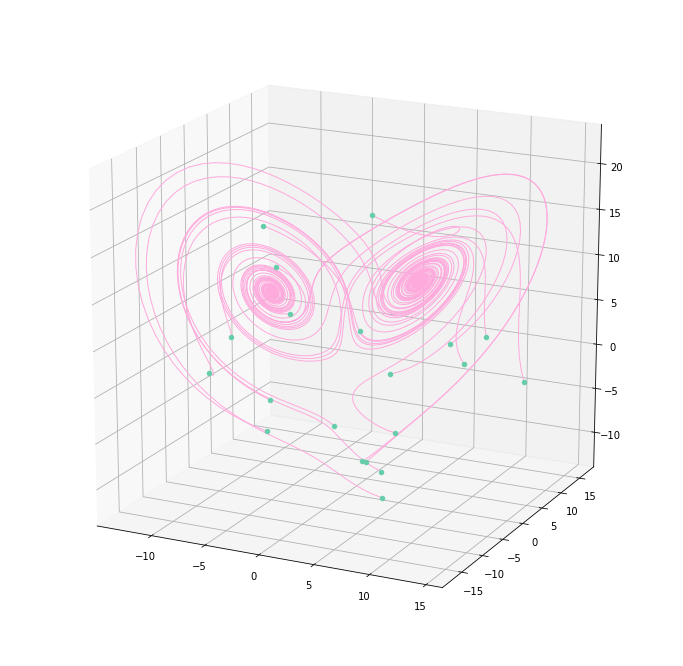

In [67]:
plt.rcParams['figure.figsize'] = [12, 12]
fig,ax = plt.subplots(1,1,subplot_kw={'projection': '3d'})

n = 20

for j in range(n):
    #nn_input[j*(len(t)-1):(j+1)*(len(t)-1),:] = x_t[j,:-1,:]
    #nn_output[j*(len(t)-1):(j+1)*(len(t)-1),:] = x_t[j,1:,:]
    x, y, z = X[1:,:,j]
    ax.plot(x, y, z,linewidth=1,c=millenialPink)
    ax.scatter(x0[j,0],x0[j,1],x0[j,2],color=mediumAquamarine)
             
ax.view_init(18, -64)
plt.savefig('./Images/lorenzsample.png')
plt.show()


In [68]:
# NN time
# Create a neural network
model = keras.Sequential()
model.add(keras.layers.Dense(32,activation='sigmoid'))
model.add(keras.layers.Dense(32,activation='tanh'))
model.add(keras.layers.Dense(32,activation='selu'))
model.add(keras.layers.Dense(32,activation='sigmoid'))
model.add(keras.layers.Dense(32,activation='tanh'))
model.add(keras.layers.Dense(32,activation='selu'))
model.add(keras.layers.Dense(3)) # only predict the 3 x,y,z out

In [69]:
# Lowering learning rate, becauase default doesn't seem to work well
o = keras.optimizers.SGD(learning_rate=0.00001)

In [70]:
model.compile(optimizer=o,loss='mean_squared_error')
mF = model.fit(Xtrain,Y[:,1:],epochs=256,validation_split=0.5,shuffle=True,verbose=1,workers=4)

Train on 153600 samples, validate on 153600 samples
Epoch 1/256
153600/153600 [==============================] - 69s 446us/step - loss: 72.3717 - val_loss: 237.9269
Epoch 2/256
153600/153600 [==============================] - 124s 809us/step - loss: 55.9407 - val_loss: 224.6367
Epoch 3/256
  5216/153600 [>.............................] - ETA: 2:48 - loss: 55.7122 ETA: 1:58 - loss: 5 - E - ETA: 2:43 - loss: 5

/usr/local/lib/python3.7/site-packages/keras/callbacks/callbacks.py:95: RuntimeWarning: Method (on_train_batch_end) is slow compared to the batch update (0.111382). Check your callbacks.
  % (hook_name, delta_t_median), RuntimeWarning)


153600/153600 [==============================] - 40s 261us/step - loss: 55.2521 - val_loss: 222.5206
Epoch 4/256
153600/153600 [==============================] - 23s 148us/step - loss: 54.1202 - val_loss: 218.6301
Epoch 5/256
153600/153600 [==============================] - 23s 150us/step - loss: 51.2508 - val_loss: 208.9591
Epoch 6/256
153600/153600 [==============================] - 20s 131us/step - loss: 43.6360 - val_loss: 180.4557
Epoch 7/256
153600/153600 [==============================] - 20s 129us/step - loss: 31.3782 - val_loss: 136.4566
Epoch 8/256
153600/153600 [==============================] - 20s 131us/step - loss: 18.2735 - val_loss: 93.6310
Epoch 9/256
153600/153600 [==============================] - 23s 152us/step - loss: 10.3563 - val_loss: 68.9450
Epoch 10/256
153600/153600 [==============================] - 24s 157us/step - loss: 7.3323 - val_loss: 55.9170
Epoch 11/256
153600/153600 [==============================] - 28s 184us/step - loss: 5.9357 - val_loss: 47.6722

153600/153600 [==============================] - 27s 173us/step - loss: 1.0070 - val_loss: 11.3288
Epoch 147/256
153600/153600 [==============================] - 27s 175us/step - loss: 1.0047 - val_loss: 11.2923
Epoch 148/256
153600/153600 [==============================] - 28s 182us/step - loss: 1.0023 - val_loss: 11.3265
Epoch 149/256
153600/153600 [==============================] - 26s 167us/step - loss: 0.9999 - val_loss: 11.2905
Epoch 150/256
153600/153600 [==============================] - 25s 160us/step - loss: 0.9974 - val_loss: 11.3285
Epoch 151/256
153600/153600 [==============================] - 22s 144us/step - loss: 0.9949 - val_loss: 11.3795
Epoch 152/256
153600/153600 [==============================] - 25s 163us/step - loss: 0.9923 - val_loss: 11.2930- ETA: 0s 
Epoch 153/256
153600/153600 [==============================] - 15s 100us/step - loss: 0.9896 - val_loss: 11.3244
Epoch 154/256
153600/153600 [==============================] - 12s 79us/step - loss: 0.9869 - val_lo

153600/153600 [==============================] - 13s 87us/step - loss: 0.3056 - val_loss: 12.3017
Epoch 220/256
153600/153600 [==============================] - 13s 86us/step - loss: 0.2989 - val_loss: 12.3206
Epoch 221/256
153600/153600 [==============================] - 13s 85us/step - loss: 0.2926 - val_loss: 12.1625
Epoch 222/256
153600/153600 [==============================] - 13s 85us/step - loss: 0.2866 - val_loss: 12.1070
Epoch 223/256
153600/153600 [==============================] - 13s 85us/step - loss: 0.2809 - val_loss: 12.0793
Epoch 224/256
153600/153600 [==============================] - 13s 83us/step - loss: 0.2755 - val_loss: 12.0843
Epoch 225/256
153600/153600 [==============================] - 16s 104us/step - loss: 0.2704 - val_loss: 12.0244
Epoch 226/256
153600/153600 [==============================] - 13s 85us/step - loss: 0.2655 - val_loss: 11.7003 ETA: 0s
Epoch 227/256
153600/153600 [==============================] - 13s 88us/step - loss: 0.2609 - val_loss: 11.88

In [71]:
# Predictions
p = np.zeros((800,4))
print(p.shape)
p[0,1:] = np.array([X[1:,0,0]])
p[0,0] = 10
q = X[0,0,0]
for i in range(p.shape[0]-1):
    p[i+1,1:] = model.predict(np.array([p[i]]))
    p[i+1,0] = q

(800, 4)


In [72]:
print(p)
print(p.shape)

[[10.          5.89407557 -6.41581995 -8.19445639]
 [10.          1.66390383 -2.97848797 -6.72124147]
 [10.          0.6632551  -2.74065351 -7.60543776]
 ...
 [10.          6.45331287 12.04915428 21.21878052]
 [10.          6.45331287 12.04915619 21.21878433]
 [10.          6.45331192 12.04915619 21.21878433]]
(800, 4)


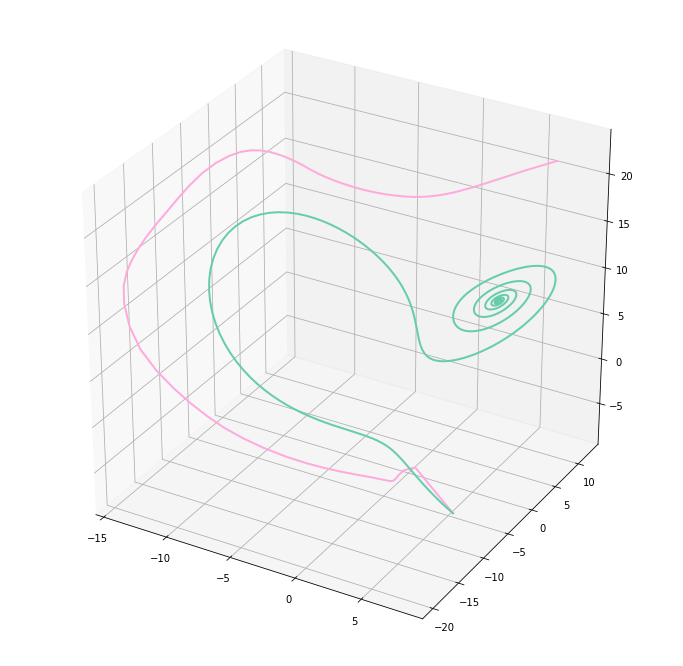

In [73]:
plt.rcParams['figure.figsize'] = [12, 12]
fig,ax = plt.subplots(1,1,subplot_kw={'projection': '3d'})


x, y, z = p[:,1:].T
      
ax.plot(x, y, z,linewidth=2,c=millenialPink)

x, y, z = X[1:,:,0]
      
ax.plot(x, y, z,linewidth=2,c=mediumAquamarine)
             
#ax.view_init(18, -64)
plt.savefig('./Images/lorenzModel.png')
plt.show()

In [74]:
# Test for new rhos
r = 35

n = 5
np.random.seed(123)
x0 = -15 + 30 * np.random.random((n, 3))

In [75]:
tX = integrate.odeint(lorenz_deriv, x0[0], t, args=(r,)).T

print(tX.shape)
print(x0[0])

(3, 801)
[ 5.89407557 -6.41581995 -8.19445639]


In [76]:
def Predict(model,rho,x0,t):
    p = np.ones((t,4))
    p[0,1:] = x0
    p[0,0] = rho
    for i in range(t-1):
        p[i+1,1:] = model.predict(np.array([p[i]]))
        p[i+1,0] *= rho
    return p

In [77]:
p = Predict(model,r,x0[0],1600)

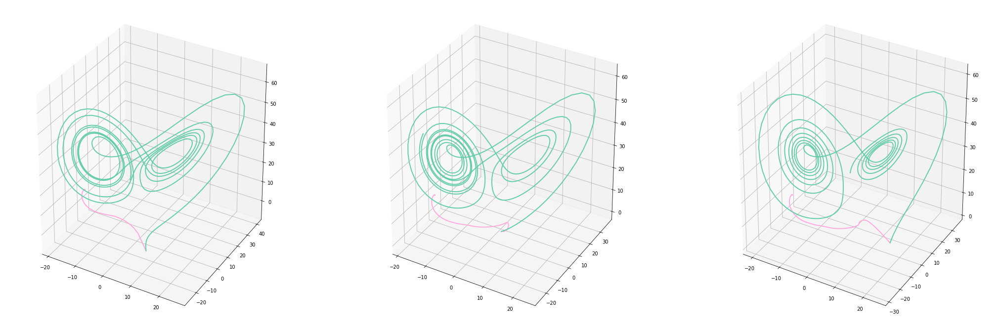

In [78]:
plt.rcParams['figure.figsize'] = [36, 12]
fig,axs = plt.subplots(1,3,subplot_kw={'projection': '3d'})

for i in range(len(axs)):
    
    p = Predict(model,r,x0[i],800)
    x, y, z = p.T[1:]

    axs[i].plot(x, y, z,linewidth=2,c=millenialPink)

    x, y, z = integrate.odeint(lorenz_deriv, x0[i], t, args=(r,)).T

    axs[i].plot(x, y, z,linewidth=2,c=mediumAquamarine)
             
#ax.view_init(18, -64)
plt.savefig('./Images/lorenzEval_35.png')
plt.show()